## Proposal
Calf muscle produces a force parallel to the leg

While in plantar flexion, the calf muscle is the primary driver of forward force

Hypothesis: plantar flexion has a unique accelerometer signal that corresponds to the force applied by the calf muscle

Proposal: Train a model to predict the force that will be applied at plantar flexion based on the 1) signal data of the past (i.e. rolling window with RNN) and 2) stride up to that point (i.e. model with memory only of the current stride)

Use traditional machine learning models and compare with newer models that can incorperate more signal memory

Has the potential to be **subject specific** and a bit self-training; given a normal walking pattern, and a subject’s weight/height the plantar flexion signal should be relatively constant 
- Put the person in the exo, allow them to walk, let the exo train off of their data and their plantar flexion, and then the exo can begin to predict 

Methods: 
1. Analyze data to find plantar flexion & plantar flexion force; define set of parameters to characterize this signal (if this can’t be done, just use video to mark plantar flexion and assume force will be calculated another way (like EEG)).

2. Using training data with marked force and force magnitude of calf, train model to predict how much force participant will exert for each step, in real time
A. LDA and feature selection (traditional method) over each stride
B. LDA and feature selection over rolling window (likely not to work very well, but good to show)
C. LSTM over each stride
D. LSTM over rolling window (hypothesized to work best)

## Midterm Progress

1. Gathered data
2. Practiced Reinforcement Learning in Julia
3. Decided to re-pupose proposal away from reinforcement learning for now, based on data, literature, time constraints, etc. 
4. Wrote above (new) proposal
5. Data pre-processing: Load data, interpolate data, correlate data between both feet; filtering to remvoe noise; 
6. Looking through literature to find good filtering parameters 
7. (offline from Julia: understanding how to correlate moments in video taken to data)

We have spent a lot of time on pre-processing and repurposing proposal, but we figure getting a good set up will make the implementation of machine learning much better! Moreover, we are learning much about Julia in the process!

In [67]:
IJulia.clear_output(true)

0

In [1]:
using Pkg

In [82]:
Pkg.add("LaTeXStrings")

 Resolving package versions...
  Updating `~/.julia/environments/v1.0/Project.toml`
  [b964fa9f] + LaTeXStrings v1.0.3
  Updating `~/.julia/environments/v1.0/Manifest.toml`
 [no changes]


In [54]:
Pkg.add("PyPlot")

  Updating registry at `~/.julia/registries/General`
  Updating git-repo `https://github.com/JuliaRegistries/General.git`
Fetching: [========================================>]  100.0 %.0 %               ]  60.4 % [=====================================>   ]  90.7 % Resolving package versions...
 Installed IJulia ─ v1.14.1
  Updating `~/.julia/environments/v1.0/Project.toml`
  [7073ff75] ↑ IJulia v1.13.0 ⇒ v1.14.1
  Updating `~/.julia/environments/v1.0/Manifest.toml`
  [7073ff75] ↑ IJulia v1.13.0 ⇒ v1.14.1
  Building IJulia → `~/.julia/packages/IJulia/DL02A/deps/build.log`


In [1]:
Pkg.add("DataFrames")
Pkg.add("CSV")
Pkg.add("Interpolations")
Pkg.add("Dierckx")
Pkg.add("StatsBase")
Pkg.add("DSP")
Pkg.add("MATLAB")
Pkg.add("Images")
Pkg.add("Flux")
Pkg.add("StatsBase")

UndefVarError: UndefVarError: Pkg not defined

In [9]:
using Pkg
using CSV
using Statistics
using Interpolations
using Dierckx
using StatsBase
using Plots
using DSP
using MATLAB
using Images
using PyPlot

using Flux
using Flux: onehot, chunk, batchseq, throttle, crossentropy
using StatsBase: wsample
using Base.Iterators: partition

In [10]:
unsqueeze(x::Array) = reshape(x, (size(x)...,1))

unsqueeze (generic function with 1 method)

In [11]:
prctile(x::Array,p) = sort(x,dims=1)[Int(round((p/100)*length(x)))]

prctile (generic function with 1 method)

In [12]:
mutable struct RawDat
    F1
    F2
    S1
    S2
end

### Data processing
filtering (not used rn), interpolation, finding strides, etc

10.008460548096377
49
44
10.009721203228173
51
47
10.00738958583949
83
45
10.007757243896874


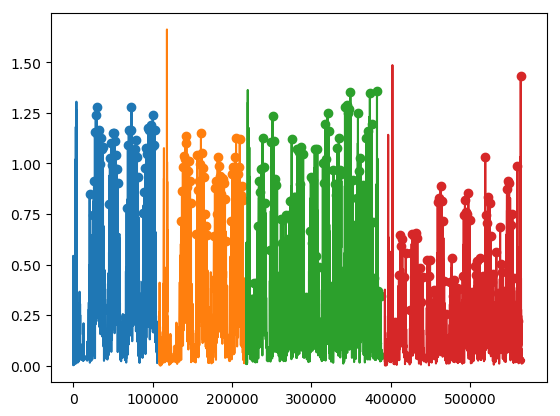

82
48


In [13]:
data_cat = Array{Float64}(undef, 0,7);
data_int = Array{Float64}(undef, 0,7);
data_filt = Array{Float64}(undef, 0,7);
data_cat0 = Array{Float64}(undef, 0,7);

rawdata = RawDat(0,0,0,0);
num_timepts = [];
filenames = [];
stride_bool_f = [];
rA_f = [];
locs_f = [];
strides_f = [];
fin_time_f = [];
cycle_mat=[];

start_time = 0;
plotly()
PyPlot.plot()
for f in filter(x -> endswith(x, "csv"), readdir())
#     println(f[1])
#     p = plot()
#     pyplot()
    global data_cat, num_timepts, data_filt, data_fin, fin_time_f, avg_int
    push!(filenames,f)
    data = CSV.read(f,datarow=3,header=2,normalizenames=true)
    data = convert(Array, delete!(data[2:9], :Event_Flags));
    fin_time = range(0, stop = data[end,1], length = size(data,1))
#     println(fin_time)
    data = convert(Array{Float64},data)
    # Need to interpolate so that time interval is the same over the whole signal and across both feet
#     plot!(p,data[:,1], data[:,2:7])
    
    avg_int = mean((data[2:end,1]-data[1:end-1,1]));
    println(mean(fin_time[2:end]-fin_time[1:end-1]))
#     println(avg_int)
    Fs = 1/(avg_int/1000);
    Fsfin = 1/(mean((fin_time[2]-fin_time[1]))/1000);
    # Filter with a low-pass because the frequency of normal walking is ~2Hz; anything far abouve this is likely noise
    lowfilt = Filters.Lowpass(5, fs = Fs);
    # Filter with highpass to account for gravity (from literature)
    highfilt = Filters.Highpass(.8, fs = Fs);
    designmethod = Elliptic(4, 0.5, 30)
    interpol = data;
    filtered = data;
    for i in 1:6
        interpol[:,i+1] = unsqueeze(Spline1D(data[:,1], data[:,i+1]; k=1)(fin_time));
        filtered[:,i+1] = unsqueeze(filt(digitalfilter(lowfilt, designmethod), interpol[:,i+1]))
        filtered[:,i+1] = unsqueeze(filt(digitalfilter(highfilt, designmethod), filtered[:,i+1]))
#         pks, locs = mxcall(:findpeaks,2,filtered[:,i+1])
    end
    fin_time = fin_time .+ start_time
    interpol[:,1] = fin_time;
    filtered[:,1] = fin_time;
    
    global filtered
    sig = (filtered[:,2:4]./maximum(filtered[:,2:4], dims=1)).^2
    global sig
    rA = sqrt.(sum(sig, dims=2))
    global rA
    if cmp(f, "S")==1
        pk_perc = 50;
        pk_dist = 130;
    else
        pk_perc = 90;
        pk_dist = 90;
    end
    strides,locs = mxcall(:findpeaks,2,rA,"MinPeakHeight",prctile(rA,pk_perc),"MinPeakDistance",pk_dist);
    strides2,locs2 = mxcall(:findpeaks,2,rA[1:750,:],"MinPeakHeight",prctile(rA[1:750,:],97));
    global locs, rA
#     println(length(strides))
    strides = strides[locs.>1000];
    locs = locs[locs.>1000];
    
    PyPlot.plot(fin_time, rA)
    PyPlot.scatter(fin_time[Int.(locs)],strides)

    strides_bool = Int.(zeros(length(fin_time)));
    strides_bool[Int.(locs)] = ones(length(locs));
    
#     end_time = abs(filtered[end,1]-3000)
#     strides = strides[1:argmin(abs.(locs.-end_time))];
#     locs = locs[1:argmin(abs.(locs.-end_time))];
#     plot(fin_time, rA, show=true)
#     scatter!(fin_time[Int.(locs)],strides,show=true)
    calib_pt = round(mean(locs2));
    
    keep_inds = Int.(zeros(Int(locs[1])));
    kl = locs[2:end]
    global cycle_mat
    for (l, sloc) in enumerate(kl)
        s_to_s = abs(sloc-locs[l]);
#         println(s_to_s*avg_int)
        if s_to_s*avg_int > 1700
            
#             println("deleted")
            keep_inds = [keep_inds; Int.(zeros(Int.(s_to_s)))];
        else
            keep_inds = [keep_inds; Int.(ones(Int.(s_to_s)))];
            keep_inds[Int(sloc)] = 1;
            append!(cycle_mat,convert(Array,(1:s_to_s)/s_to_s))
        end
    end
    println(sum(strides_bool))
    keep_inds = [keep_inds; Int.(zeros(Int(length(fin_time)-length(keep_inds))))]
    keep_inds = keep_inds.==1;
#     println(size(keep_inds))    
#     println(size(data))
    data_cat0 = cat(dims=1, data_cat0, data);
    strides_bool = strides_bool[keep_inds];
    println(sum(strides_bool))
    data = data[keep_inds,:];
    interpol = interpol[keep_inds,:];
    filtered = filtered[keep_inds,:];
    
    append!(rA_f, rA)
    append!(locs_f, locs)
    append!(strides_f, strides)
    append!(fin_time_f, fin_time)
    
    data_cat = cat(dims=1,data_cat,data);
    data_int = cat(dims=1, data_int, interpol);
    data_filt = cat(dims=1, data_filt, filtered);
    append!(num_timepts,size(data,1))
    append!(stride_bool_f, strides_bool)
#     display(p)
#     display(q)
    start_time = fin_time[end]+avg_int
end
# rawdat = (CSV.read(filenames[1]),CSV.read(filenames[2]),CSV.read(filenames[3]),CSV.read(filenames[4]));

In [14]:
methods(CSV.write)

# 6 methods for generic function "write":
[1] write(file::Union{IO, String}; kwargs...) in CSV at /Users/jenniferdawkins/.julia/packages/CSV/Q13EC/src/write.jl:110
[2] write(file::Union{IO, String}, itr; kwargs...) in CSV at /Users/jenniferdawkins/.julia/packages/CSV/Q13EC/src/write.jl:112
[3] write(sch::Tables.Schema{schema_names,types} where types, rows, file::Union{IO, String}; delim, quotechar, openquotechar, closequotechar, escapechar, missingstring, dateformat, append, writeheader, header, kwargs...) where schema_names in CSV at /Users/jenniferdawkins/.julia/packages/CSV/Q13EC/src/write.jl:138
[4] write(::Nothing, rows, file::Union{IO, String}; delim, quotechar, openquotechar, closequotechar, escapechar, missingstring, dateformat, append, writeheader, header, kwargs...) in CSV at /Users/jenniferdawkins/.julia/packages/CSV/Q13EC/src/write.jl:167
[5] write(sink::CSV.Sink, ::Type{T}, args...; append, transforms) where T in CSV at /Users/jenniferdawkins/.julia/packages/CSV/Q13EC/src/deprecated.jl:712
[6] write(sink::CSV.Sink, source; append, transforms) in CSV at /Users/jenniferdawkins/.julia/packages/CSV/Q13EC/src/deprecated.jl:718

### LSTM using flux
Right now, just one foot and one signal (i.e. y-acceleration, or data_int[:,4])
doesn't work rn\\

based on: https://pytorch.org/tutorials/intermediate/seq2seq_translation_tutorial.html


In [18]:
using Flux
using Flux: onehot, chunk, batchseq, throttle, crossentropy
using StatsBase: wsample
using Base.Iterators: partition
# using CuArrays

cd(@__DIR__)

# isfile("input.txt") ||
#   download("https://cs.stanford.edu/people/karpathy/char-rnn/shakespeare_input.txt",
#            "input.txt")

# text = collect(String(read("input.txt")))

# TO DO!(for now just one foot)

# longest seq = max stride length
stride_idxs = findall(stride_bool_f.==1);
cycle_time = stride_idxs[2:end]-stride_idxs[1:end-1];

label_idxs_1 = stride_idxs[1:end-1] .+ .3 .*cycle_time;
label_idxs_2 = stride_idxs[1:end-1] .+ .6 .*cycle_time;

training_idxs_1 = Int.(round.(label_idxs_2[1:end-1] .+ 1));
training_idxs_2 = Int.(round.(label_idxs_1[2:end] .- 150/avg_int));

label_idxs_1 = Int.(round.(label_idxs_1[1:end-1]));
label_idxs_2 = Int.(round.(label_idxs_2[1:end-1]));

# tend_PF = round(strides_idxs[2:end] .- 0.35.*cycle_time); # start predictions at end_PF
# start_PF = round(strides_idxs[1:end-1] .+ 0.3.*cycle_time);

# data starts at end_PF to start_PF; labels start at start_PF to end_PF;
 #xstart = data_int[tend_PF:start_PF] some sort of function for this
text = data_int[:,4]
println(minimum(text))
println(maximum(text))
stp = 100;
text = floor.(Int, (text.-minimum(text))./stp).+1
println(minimum(text))
println(maximum(text))
alphabet = [unique(text)..., 0]
text = map(ch -> onehot(ch, alphabet), text)
stop = onehot(0, alphabet)

x_in = []; y_in = [];
lx = 0; ly = 0;
for k = 1:length(cycle_time)-1
    append!(x_in, text[training_idxs_1[k]:training_idxs_2[k]]);
    ly = maximum([lx,length(text[training_idxs_1[k]:training_idxs_2[k]])+1]);
    append!(y_in, text[label_idxs_1[k]:label_idxs_2[k]])
    ly = maximum([ly,length(text[label_idxs_1[k]:label_idxs_2[k]])+1]);
end
# t

N = length(alphabet)
# seqlen = 50
seqlenx = lx;
seqleny = ly;
nbatch = 1
max_len = seqlen;

h_size = 32;

Xs = collect(partition(batchseq(chunk(x_in, nbatch), stop), seqlenx))
Ys = collect(partition(batchseq(chunk(y_in, nbatch), stop), seqleny))

encoder = Chain(
  LSTM(N, h_size))

decoder = Chain(
#     relu(),
    LSTM(h_size, h_size),
    Dense(h_size, seqlen),
    softmax)

encoder = gpu(encoder);
decoder = gpu(decoder);

function loss(xs, ys)
  l = sum(crossentropy.(decoder.(gpu.(xs)), gpu.(ys)))
#   Flux.truncate!(decoder)
  return l
end

# opt = ADAM(params(m), 0.01)
# tx, ty = (gpu.(Xs[5]), gpu.(Ys[5]))
# evalcb = () -> @show loss(tx, ty)

# num_epochs = 30;
# for epoch in 1:num_epochs
#     for seq in 1:length(Xs)
    
#         for ei in 1:seqlenx
#             out[ei] = Tracker.forward(encoder, Xs[seqlenx][ei])
# #             hidden[i] = encoder[1].state;
            
#         end
#         decoder[1].state = encoder[1].state;
#         for di in 1:seqleny
#             dec_out = Tracker.forward(decoder, Ys[seqleny][di])
            
#             loss += loss(dec_out, Ys[di]);
# #         for di in 1:
#         end
#         Tracker.back!(decoder, loss);
#         Tracker.back!(encoder, loss);
#     end
# end

-7219.940268824218
8469.965315830792
1
157


UndefVarError: UndefVarError: seqlen not defined

2018-11-20 19:23:06.442 MATLAB_maci64[5397:2252620] kCFURLVolumeIsAutomountedKey missing for file:///private/var/folders/zz/zyxvpxvq6csfxvn_n0000000000000/T/FPInstallMountPoint/: Error Domain=NSCocoaErrorDomain Code=257 "The file “FPInstallMountPoint” couldn’t be opened because you don’t have permission to view it." UserInfo={NSURL=file:///private/var/folders/zz/zyxvpxvq6csfxvn_n0000000000000/T/FPInstallMountPoint/, NSFilePath=/private/var/folders/zz/zyxvpxvq6csfxvn_n0000000000000/T/FPInstallMountPoint, NSUnderlyingError=0x7ff5ad5d7eb0 {Error Domain=NSPOSIXErrorDomain Code=13 "Permission denied"}}


### LSTM using flux
Right now, just one foot and one signal (i.e. y-acceleration, or data_int[:,4])


New try; \\
based on https://github.com/FluxML/model-zoo/blob/master/text/phonemes/1-model.jl

In [236]:
using Flux
using Flux: onehot, chunk, batchseq, throttle, crossentropy
using StatsBase: wsample
using Base.Iterators: partition
# using CuArrays

cd(@__DIR__)

# isfile("input.txt") ||
#   download("https://cs.stanford.edu/people/karpathy/char-rnn/shakespeare_input.txt",
#            "input.txt")

# text = collect(String(read("input.txt")))

# TO DO!(for now just one foot)

# longest seq = max stride length
strides_idxs = findall(stride_bool_f.==1);
cycle_time = stride_idxs[2:end]-stride_idxs[1:end-1];

label_idxs_1 = stride_idxs[1:end-1] .+ .3 .*cycle_time;
label_idxs_2 = stride_idxs[1:end-1] .+ .6 .*cycle_time;

training_idxs_1 = Int.(round.(label_idxs_2[1:end-1] .+ 1));
training_idxs_2 = Int.(round.(label_idxs_1[2:end] .- 150/avg_int));

label_idxs_1 = Int.(round.(label_idxs_1[1:end-1]));
label_idxs_2 = Int.(round.(label_idxs_2[1:end-1]));

# tend_PF = round(strides_idxs[2:end] .- 0.35.*cycle_time); # start predictions at end_PF
# start_PF = round(strides_idxs[1:end-1] .+ 0.3.*cycle_time);

# data starts at end_PF to start_PF; labels start at start_PF to end_PF;
 #xstart = data_int[tend_PF:start_PF] some sort of function for this
text = data_int[:,4]
stp = 100;
text = floor.(Int, (text.-minimum(text))./stp).+1
alphabet = [unique(text)..., 0]
text = map(ch -> onehot(ch, alphabet), text)
stop = onehot(0, alphabet)

x_in = []; y_in = [];
lx = 0; ly = 0;
for k = 1:length(cycle_time)-1
    append!(x_in, text[training_idxs_1[k]:training_idxs_2[k]]);
    ly = maximum([lx,length(text[training_idxs_1[k]:training_idxs_2[k]])+1]);
    append!(y_in, text[label_idxs_1[k]:label_idxs_2[k]])
    ly = maximum([ly,length(text[label_idxs_1[k]:label_idxs_2[k]])+1]);
end
# t

N = length(alphabet)
# seqlen = 50
seqlenx = lx;
seqleny = ly;
nbatch = 1
max_len = seqlen;

h_size = 32;

Xs = collect(partition(batchseq(chunk(x_in, nbatch), stop), seqlenx))
Ys = collect(partition(batchseq(chunk(y_in, nbatch), stop), seqleny))

encoder = Chain(
  LSTM(N, h_size))

decoder = Chain(
#     relu(),
    LSTM(h_size, h_size),
    Dense(h_size, seqlen),
    softmax)

function model(x,y)
    return decoder(encoder(x))
end

encoder = gpu(encoder);
decoder = gpu(decoder);

model = gpu(model)

function loss(xs, ys)
  l = sum(crossentropy.(model.(gpu.(xs)), gpu.(ys)))
#   Flux.truncate!(decoder)
  return l
end

# opt = ADAM(params(m), 0.01)
# tx, ty = (gpu.(Xs[5]), gpu.(Ys[5]))
# evalcb = () -> @show loss(tx, ty)

num_epochs = 30;
for epoch in 1:num_epochs
    for seq in 1:length(Xs)
    
        for ei in 1:seqlenx
            out[ei] = Tracker.forward(encoder, Xs[seqlenx][ei])
#             hidden[i] = encoder[1].state;
            
        end
        decoder[1].state = encoder[1].state;
        for di in 1:seqleny
            dec_out = Tracker.forward(decoder, Ys[seqleny][di])
            
            loss += loss(dec_out, Ys[di]);
#         for di in 1:
        end
        Tracker.back!(decoder, loss);
        Tracker.back!(encoder, loss);
    end
end

DivideError: DivideError: integer division error

Plot uninterpolated data

In [18]:
plot(data_int[1:num_timepts[1],1],data_int[1:num_timepts[1],2:7])
# title("Interpolated Data")

Plot with Low pass filter only

In [19]:
plot(data_filt[1:num_timepts[1],1],data_filt[1:num_timepts[1],2:7])

Plot with HighPass and LowPass Filter (needs parameter tuning)

In [20]:
plot(data_filt[1:num_timepts[1],1],data_filt[1:num_timepts[1],2:7])

The rest of the notebook is simply work-in-progress code (things we're trying, etc, but nothing formalized)

In [12]:
cross_corr(x,y) = conv(conj(x),y);

In [69]:
# Correlate foot 1 and foot 2, then foot 3 and foot 4 (bc timing of first is off a bit)
Fs = 1/((data_cat[2,1]-data_cat[1,1])/1000); # Sampling frequency is 1/(time interval)
foot1 = data_cat[1:5000,2:end]; foot2 = data_cat[num_timepts[1]+1:num_timepts[1]+5000,2:end];
foot3 = data_cat[sum(num_timepts[1:2])+1:sum(num_timepts[1:2])+5000,2:end];
foot4 = data_cat[sum(num_timepts[1:3])+1:sum(num_timepts[1:3])+5000,2:end];
acor, lag = mxcall(:xcorr, 2, foot1[:,1], foot2[:,1]);
# println(size(acor))
~,I = findmax(abs.(acor))
lagdiff = lag[I];
timediff = lagdiff/Fs
println(acor[1:10])
println(timediff)
println((data_cat[2,1]-data_cat[1,1]))

[5.59181e7, 1.32227e8, 2.31906e8, 3.59007e8, 4.68747e8, 5.23132e8, 5.55197e8, 5.70468e8, 5.79785e8, 5.97044e8]
0.23019459260621664
10.008460548096377


In [42]:
abs.([1,2,3,-2])

4-element Array{Int64,1}:
 1
 2
 3
 2

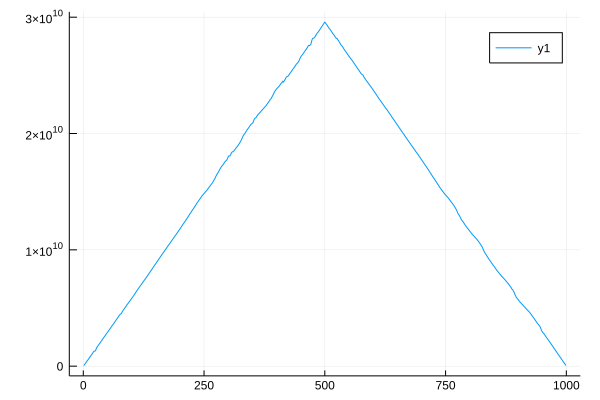

In [50]:
plot(acor)

In [44]:
println(length(rawdata.S1[2:9]))
x = delete!(rawdata.S1[2:9],:Event_Flags)

timepts = x[:Timestamp_ms_]
# avg_int = mean(timepts[2:end]-timepts[1:end-1])
size(timepts)

MethodError: MethodError: no method matching getindex(::Int64, ::UnitRange{Int64})
Closest candidates are:
  getindex(::Number) at number.jl:75
  getindex(::Number, !Matched::Integer) at number.jl:77
  getindex(::Number, !Matched::Integer...) at number.jl:82
  ...

In [50]:
rawdata.s1f1

,Timestamp,Timestamp_ms_,Event_Flags,Accel_X,Accel_Y,Accel_Z,Gyro_X,Gyro_Y,Gyro_Z,Strain,Analog_0_,Analog_1_,Analog_2_,Analog_3_,Analog_4_,Analog_5_,Analog_6_,Analog_7_,Motor_Current,Encoder,Encoder_Velocity,Battery_Voltage,Int_Voltage,Temperature,Status1,Status2,Sine_Commut_PWM
,String⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰
1,Tue Oct 16 2018,11,0,-7660,392,-1114,-47,-11,9,65533,65534,169,0,0,0,0,0,0,0,-12,0,199,1,126,1,129,0
2,Tue Oct 16 2018,25,0,-7696,320,-1162,-56,-13,11,65533,65534,155,0,0,0,0,0,0,27,-12,0,199,1,126,1,129,0
3,Tue Oct 16 2018,35,0,-7642,332,-1118,-58,-13,5,65533,65534,165,0,0,0,0,0,0,0,-12,0,199,1,126,1,129,0
4,Tue Oct 16 2018,44,0,-7638,308,-1108,-62,-14,13,65533,65534,169,0,0,0,0,0,0,-18,-12,0,199,1,126,1,129,0
5,Tue Oct 16 2018,54,0,-7684,320,-1160,-60,-15,6,65533,65534,167,0,0,0,0,0,0,0,-12,0,199,1,126,1,129,0
6,Tue Oct 16 2018,65,0,-7604,318,-1140,-61,-13,13,65533,65534,159,0,0,0,0,0,0,0,-12,0,199,1,126,1,129,0
7,Tue Oct 16 2018,74,0,-7644,322,-1086,-60,-16,9,65533,65534,167,0,0,0,0,0,0,-18,-12,0,199,1,126,1,129,0
8,Tue Oct 16 2018,84,0,-7616,328,-1150,-55,-23,8,65533,65534,165,0,0,0,0,0,0,-36,-12,0,199,1,126,1,129,0
9,Tue Oct 16 2018,94,0,-7676,314,-1122,-55,-15,6,65533,65534,159,0,0,0,0,0,0,9,-12,0,199,1,126,1,129,0


In [42]:
s1f1 = CSV.read("Stair1_Foot1.csv",datarow=3,header=2,normalizenames=true)
s1f1[1:5,:]

,Timestamp,Timestamp_ms_,Event_Flags,Accel_X,Accel_Y,Accel_Z,Gyro_X,Gyro_Y,Gyro_Z,Strain,Analog_0_,Analog_1_,Analog_2_,Analog_3_,Analog_4_,Analog_5_,Analog_6_,Analog_7_,Motor_Current,Encoder,Encoder_Velocity,Battery_Voltage,Int_Voltage,Temperature,Status1,Status2,Sine_Commut_PWM
,String⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰,Int64⍰
1,Tue Oct 16 2018,11,0,-7656,-280,-1396,9,-41,23,65533,65534,138,0,0,0,0,0,0,-27,-10,0,199,1,124,1,129,0
2,Tue Oct 16 2018,23,0,-7620,-358,-1398,37,-48,26,65533,65534,117,0,0,0,0,0,0,-18,-10,0,199,1,124,1,129,0
3,Tue Oct 16 2018,33,0,-7678,-308,-1384,54,-46,36,65533,65534,134,0,0,0,0,0,0,-18,-10,0,199,1,124,1,129,0
4,Tue Oct 16 2018,43,0,-7620,-354,-1428,98,-57,36,65533,65534,134,0,0,0,0,0,0,-9,-10,0,199,1,124,1,129,0
5,Tue Oct 16 2018,53,0,-7604,-310,-1416,126,-61,44,65533,65534,138,0,0,0,0,0,0,-27,-10,0,199,1,125,1,129,0


In [45]:
s1f2 = CSV.read("Stair1_Foot2.csv",datarow=3,header=2,normalizenames=true)
f1f1 = CSV.read("FlatGround_Foot1.csv",datarow=3,header=2,normalizenames=true)
f1f2 = CSV.read("FlatGround_Foot2.csv",datarow=3,header=2,normalizenames=true)
size(f1f2)

(10905, 27)

In [41]:
# testing linear interpolation
# x is a tuple where each element of the tuple is a position your data is sampled at
# y is your data
# the interpolation will give you one value at each integer, and only give you
# as many values as x-values that you provide

x = (float([11,19,28,37,40,50,60]/10),)
y = float([5,6,7,8,9,11,13])
itp = interpolate(x, y, Gridded(Linear()))

7-element interpolate((::Array{Float64,1},), ::Array{Float64,1}, Gridded(Linear())) with element type Float64:
 #undef             
   6.111111111111112
   7.222222222222222
   9.0              
  11.0              
  13.0              
 #undef             

In [64]:
f1f1_times = append!([0], f1f1[2])  # fencepost; this data is in milliseconds, sampling is ~once every 10 ms
f1f1_accelX = append!([f1f1[4][1]], f1f1[4])  # also fencepost

itp = interpolate((f1f1_times/10,), f1f1_accelX, Gridded(Linear()))  # each point is at exactly 10, 20, 30... milliseconds
# todo:
# - interpolate for all 6 data columns
# - make a data frame
# - cross correlate

10876-element interpolate((::Array{Float64,1},), ::Array{Int64,1}, Gridded(Linear())) with element type Float64:
 -7660.0            
 -7683.142857142857 
 -7669.0            
 -7639.777777777778 
 -7665.599999999999 
 -7640.363636363636 
 -7626.222222222223 
 -7627.200000000001 
 -7652.0            
 -7683.200000000001 
 -7669.454545454546 
 -7642.888888888889 
 -7616.0            
     ⋮              
 -7625.55555555557  
 -7659.599999999962 
 -7653.999999999994 
 -7661.999999999992 
 -7666.0            
 -7643.60000000002  
 -7682.799999999959 
 -7658.800000000032 
 -7630.8000000000175
 -7657.999999999971 
 -7622.363636363618 
 -7623.111111111101 

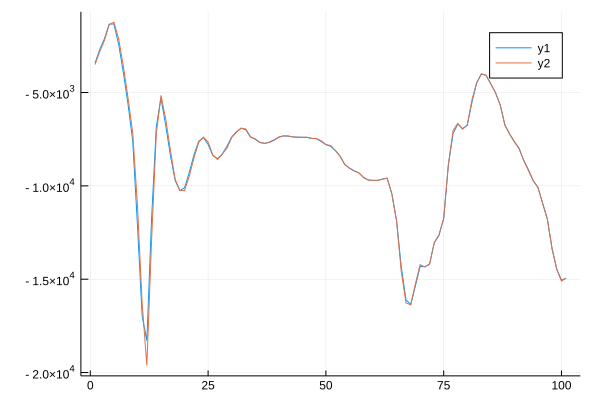

In [79]:
plot(Array(itp)[5000:5100])
plot!(f1f1[4][4996:5096])  # why is it off by 6? 

In [60]:
Array(itp)

17459-element Array{Float64,1}:
 -7656.0            
 -7629.0            
 -7660.6            
 -7637.4            
 -7608.799999999999 
 -7595.6            
 -7566.8            
 -7578.400000000001 
 -7595.0            
 -7605.636363636364 
 -7594.0            
 -7602.799999999999 
 -7605.8            
     ⋮              
 -7629.799999999945 
 -7663.600000000006 
 -7658.200000000026 
 -7637.600000000064 
 -7600.599999999962 
 -7625.39999999998  
 -7637.600000000006 
 -7637.799999999945 
 -7668.000000000058 
 -7633.1999999999825
 -7644.0            
 -7644.3636363636315

In [81]:
plot(s1f2[5,1:100])

BoundsError: BoundsError: attempt to access 27-element Array{AbstractArray{T,1} where T,1} at index [1:100]

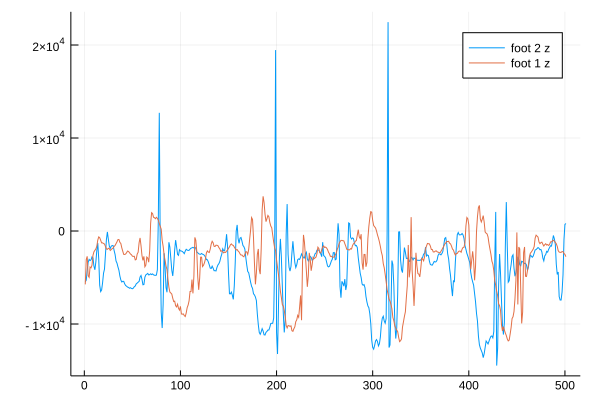

In [82]:
#plot(f1f2[4][2500:3000])  # x
#plot(f1f2[5][2500:3000])  # y
plot(f1f2[6][2500:3000], label="foot 2 z")  # z
#plot!(f1f1[4][2500:3000])  # x
#plot!(f1f1[5][2500:3500])  # y
plot!(f1f1[6][2500:3000], label="foot 1 z")  # z

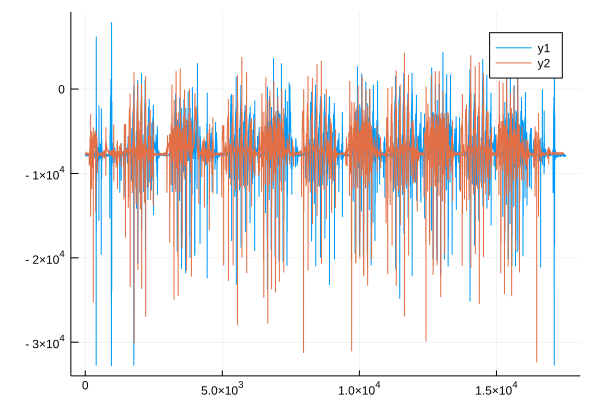

In [84]:
plot(s1f2[4])  # x
#plot!(f1f2[5][2500:3500])  # y
#plot!(f1f2[6][2500:3500])  # z
plot!(s1f1[4])  # x
#plot!(f1f1[5][2500:3500])  # y
#plot!(f1f1[6][2500:3500])  # z

In [132]:
out = forward(encoder, params(Xs[1][1]))

UndefVarError: UndefVarError: forward not defined